<a href="https://colab.research.google.com/github/anandkhushboo1311/Python-projects/blob/main/Weather_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
import pandas as pd
import numpy as np

In [5]:
weather = pd.read_csv("/content/Weather1.csv", index_col="DATE")

In [6]:
null_pct = weather.apply(pd.isnull).sum()/weather.shape[0]

In [7]:
weather

,STATION,NAME,ACMH,ACSH,AWND,FMTM,PGTM,PRCP,SNOW,SNWD,...,WT13,WT14,WT15,WT16,WT17,WT18,WT19,WT21,WT22,WV01
DATE,,,,,,,,,,,,,,,,,,,,,
1970-01-01,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",80.0,90.0,NaN,NaN,NaN,0.00,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1970-01-02,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",30.0,20.0,NaN,NaN,NaN,0.00,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1970-01-03,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",80.0,100.0,NaN,NaN,NaN,0.02,0.0,0.0,...,NaN,NaN,NaN,1.0,NaN,1.0,NaN,NaN,NaN,NaN
1970-01-04,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",10.0,20.0,NaN,NaN,NaN,0.00,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN
1970-01-05,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",30.0,10.0,NaN,NaN,NaN,0.00,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-07-08,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",NaN,NaN,6.04,NaN,NaN,0.26,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-07-09,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",NaN,NaN,8.05,NaN,NaN,0.00,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-07-10,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",NaN,NaN,9.17,NaN,NaN,0.00,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
null_pct

,0
STATION,0.000000
NAME,0.000000
ACMH,0.498853
ACSH,0.498801
AWND,0.266601
FMTM,0.472324
PGTM,0.360628
PRCP,0.000000
SNOW,0.000000
SNWD,0.000000


In [9]:
valid_columns=weather.columns[null_pct<0.05]

In [10]:
valid_columns

Index(['STATION', 'NAME', 'PRCP', 'SNOW', 'SNWD', 'TMAX', 'TMIN'], dtype='object')

In [11]:
weather = weather[valid_columns].copy()

In [12]:
weather.columns=weather.columns.str.lower()

In [13]:
weather

,station,name,prcp,snow,snwd,tmax,tmin
DATE,,,,,,,
1970-01-01,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,28,22
1970-01-02,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,31,22
1970-01-03,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.02,0.0,0.0,38,25
1970-01-04,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,31,23
1970-01-05,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,35,21
...,...,...,...,...,...,...,...
2022-07-08,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.26,0.0,0.0,81,65
2022-07-09,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,86,69
2022-07-10,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,81,66


In [14]:
weather=weather.ffill()

In [15]:
weather.apply(pd.isnull).sum()

,0
station,0
name,0
prcp,0
snow,0
snwd,0
tmax,0
tmin,0


In [16]:
weather.dtypes

,0
station,object
name,object
prcp,float64
snow,float64
snwd,float64
tmax,int64
tmin,int64


In [17]:
weather.index

Index(['1970-01-01', '1970-01-02', '1970-01-03', '1970-01-04', '1970-01-05',
       '1970-01-06', '1970-01-07', '1970-01-08', '1970-01-09', '1970-01-10',
       ...
       '2022-07-03', '2022-07-04', '2022-07-05', '2022-07-06', '2022-07-07',
       '2022-07-08', '2022-07-09', '2022-07-10', '2022-07-11', '2022-07-12'],
      dtype='object', name='DATE', length=19186)

In [18]:
weather.index=pd.to_datetime(weather.index)

In [19]:
weather.index

DatetimeIndex(['1970-01-01', '1970-01-02', '1970-01-03', '1970-01-04',
               '1970-01-05', '1970-01-06', '1970-01-07', '1970-01-08',
               '1970-01-09', '1970-01-10',
               ...
               '2022-07-03', '2022-07-04', '2022-07-05', '2022-07-06',
               '2022-07-07', '2022-07-08', '2022-07-09', '2022-07-10',
               '2022-07-11', '2022-07-12'],
              dtype='datetime64[ns]', name='DATE', length=19186, freq=None)

In [20]:
weather.index.year.value_counts().sort_index()

,count
DATE,
1970,365
1971,365
1972,366
1973,365
1974,365
1975,365
1976,366
1977,365
1978,365


<Axes: xlabel='DATE'>

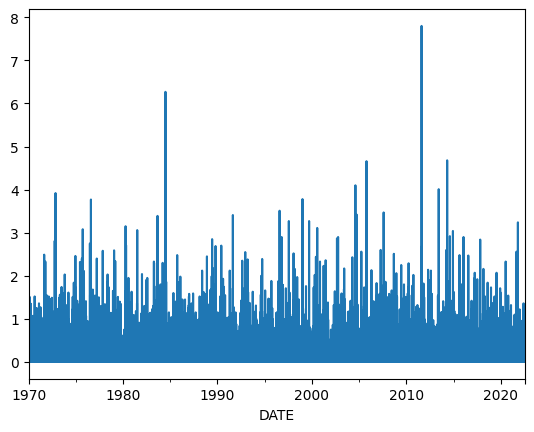

In [21]:
weather['prcp'].plot()

In [22]:
weather

,station,name,prcp,snow,snwd,tmax,tmin
DATE,,,,,,,
1970-01-01,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,28,22
1970-01-02,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,31,22
1970-01-03,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.02,0.0,0.0,38,25
1970-01-04,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,31,23
1970-01-05,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,35,21
...,...,...,...,...,...,...,...
2022-07-08,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.26,0.0,0.0,81,65
2022-07-09,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,86,69
2022-07-10,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,81,66


In [23]:
weather["target"]= weather.shift(-1)["tmax"]

In [24]:
weather

,station,name,prcp,snow,snwd,tmax,tmin,target
DATE,,,,,,,,
1970-01-01,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,28,22,31.0
1970-01-02,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,31,22,38.0
1970-01-03,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.02,0.0,0.0,38,25,31.0
1970-01-04,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,31,23,35.0
1970-01-05,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,35,21,36.0
...,...,...,...,...,...,...,...,...
2022-07-08,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.26,0.0,0.0,81,65,86.0
2022-07-09,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,86,69,81.0
2022-07-10,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,81,66,81.0


In [25]:
weather=weather.ffill()

In [26]:
weather

,station,name,prcp,snow,snwd,tmax,tmin,target
DATE,,,,,,,,
1970-01-01,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,28,22,31.0
1970-01-02,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,31,22,38.0
1970-01-03,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.02,0.0,0.0,38,25,31.0
1970-01-04,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,31,23,35.0
1970-01-05,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,35,21,36.0
...,...,...,...,...,...,...,...,...
2022-07-08,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.26,0.0,0.0,81,65,86.0
2022-07-09,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,86,69,81.0
2022-07-10,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,81,66,81.0


In [27]:
from sklearn.linear_model import Ridge
rr=Ridge(alpha=.1)

In [28]:
predictors=weather.columns[~weather.columns.isin(["target","name",'station'])]

In [29]:
predictors

Index(['prcp', 'snow', 'snwd', 'tmax', 'tmin'], dtype='object')

In [30]:
def backtest(weather,model,predictors,start=3650, step=90):
  all_predictions=[]
  for i in range(start,weather.shape[0],step):
    train=weather.iloc[:i,:]
    test=weather.iloc[i:(i+step),:]

    model.fit(train[predictors],train["target"])
    preds=model.predict(test[predictors])

    preds=pd.Series(preds,index=test.index)
    combined=pd.concat([test["target"],preds],axis=1)

    combined.columns=["actual","prediction"]

    combined["diff"]=(combined["prediction"]-combined["actual"]).abs()
    combined.plot()

    all_predictions.append(combined)
  return pd.concat(all_predictions)

/usr/local/lib/python3.10/dist-packages/pandas/plotting/_matplotlib/core.py:513: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


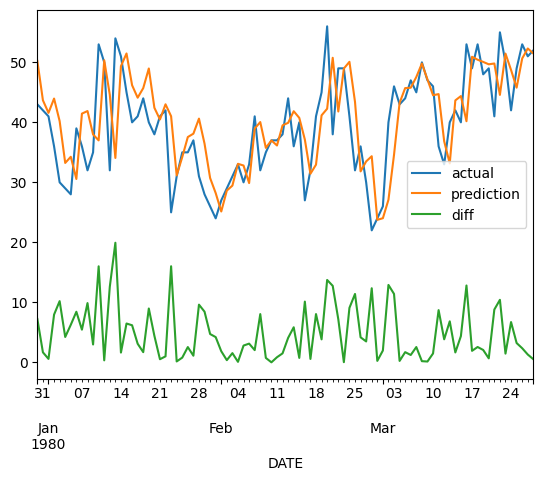

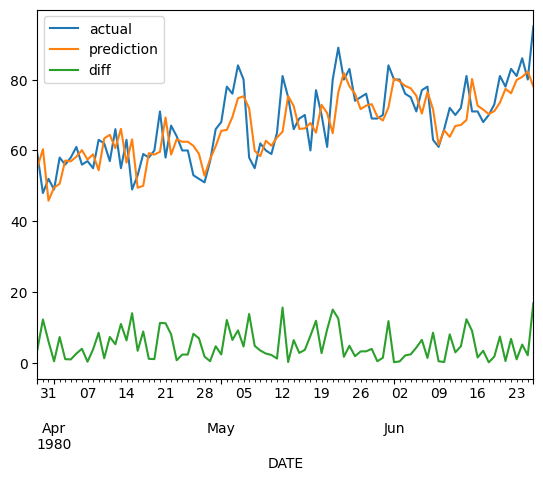

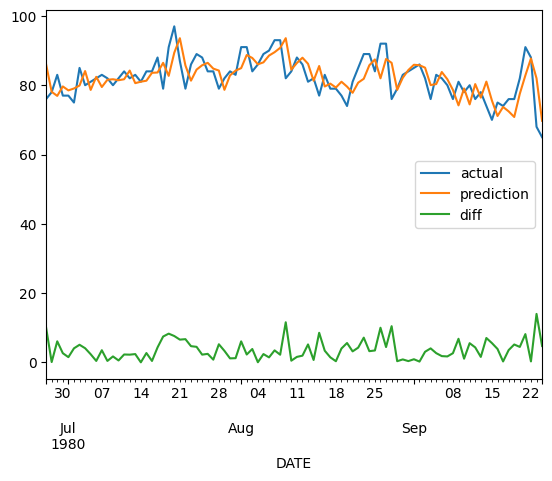

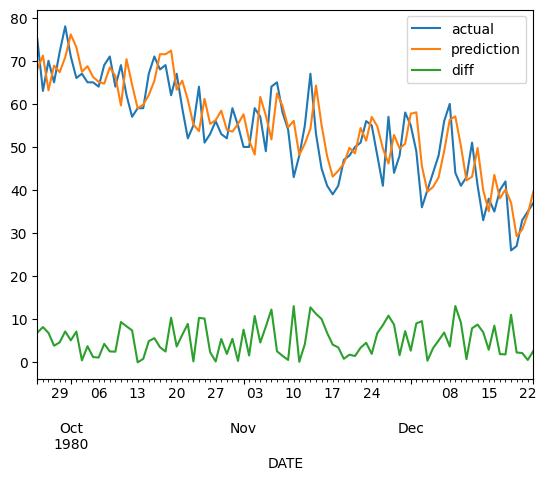

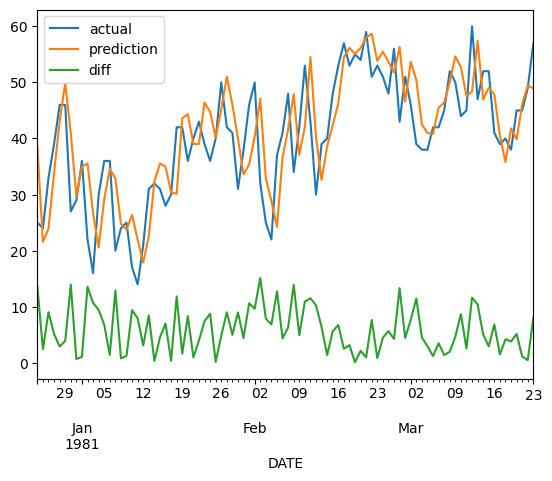

...

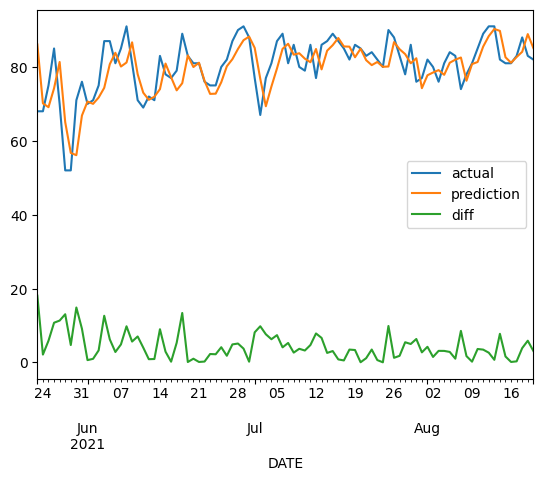

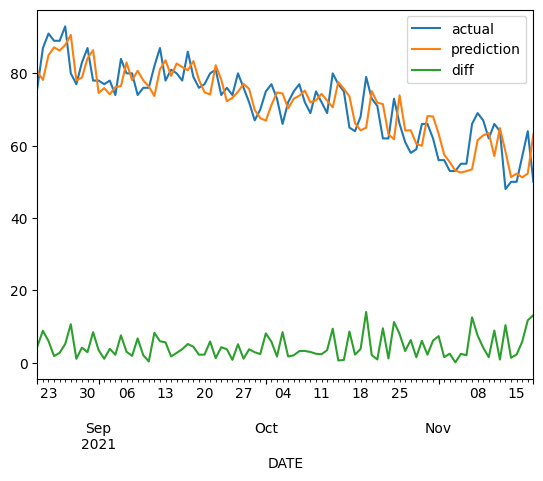

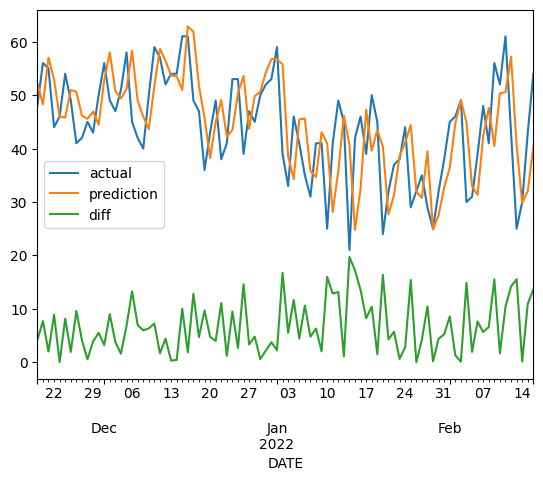

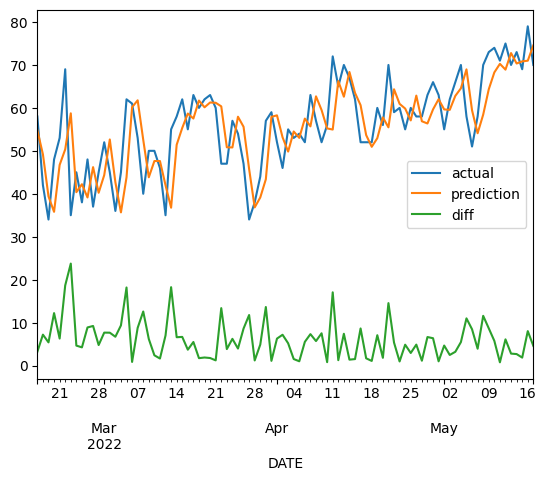

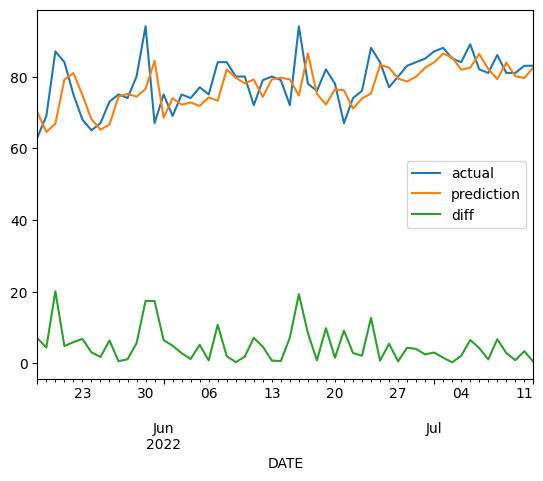

In [31]:
predictions=backtest(weather, rr, predictors)

In [32]:
predictions

,actual,prediction,diff
DATE,,,
1979-12-30,43.0,50.229324,7.229324
1979-12-31,42.0,43.673798,1.673798
1980-01-01,41.0,41.579150,0.579150
1980-01-02,36.0,43.961887,7.961887
1980-01-03,30.0,40.204726,10.204726
...,...,...,...
2022-07-08,86.0,79.262476,6.737524
2022-07-09,81.0,83.891333,2.891333
2022-07-10,81.0,80.102018,0.897982


In [33]:
from sklearn.metrics import mean_absolute_error
mean_absolute_error(predictions["actual"],predictions["prediction"])

5.1476316519496095

In [34]:
def pct_diff(old,new):
  return (new-old)/old

def computer_rolling(weather,horizon,col):
  label=f"rolling_{horizon}_{col}"

  weather[label]=weather[col].rolling(horizon).mean()
  weather[f"{label}_pct"]=pct_diff(weather[label],weather[col])
  return weather

rolling_horizons=[3,14]
for horizon in rolling_horizons:
  for col in ["tmax","tmin","prcp"]:
    weather = computer_rolling(weather,horizon,col)

In [35]:
weather

,station,name,prcp,snow,snwd,tmax,tmin,target,rolling_3_tmax,rolling_3_tmax_pct,rolling_3_tmin,rolling_3_tmin_pct,rolling_3_prcp,rolling_3_prcp_pct,rolling_14_tmax,rolling_14_tmax_pct,rolling_14_tmin,rolling_14_tmin_pct,rolling_14_prcp,rolling_14_prcp_pct
DATE,,,,,,,,,,,,,,,,,,,,
1970-01-01,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,28,22,31.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1970-01-02,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,31,22,38.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1970-01-03,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.02,0.0,0.0,38,25,31.0,32.333333,0.175258,23.000000,0.086957,0.006667,2.0,NaN,NaN,NaN,NaN,NaN,NaN
1970-01-04,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,31,23,35.0,33.333333,-0.070000,23.333333,-0.014286,0.006667,-1.0,NaN,NaN,NaN,NaN,NaN,NaN
1970-01-05,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,35,21,36.0,34.666667,0.009615,23.000000,-0.086957,0.006667,-1.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-07-08,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.26,0.0,0.0,81,65,86.0,84.000000,-0.035714,68.333333,-0.048780,0.086667,2.0,84.071429,-0.036534,67.928571,-0.043113,0.044286,4.870968
2022-07-09,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,86,69,81.0,83.000000,0.036145,67.666667,0.019704,0.086667,-1.0,83.928571,0.024681,68.142857,0.012579,0.044286,-1.000000
2022-07-10,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,81,66,81.0,82.666667,-0.020161,66.666667,-0.010000,0.086667,-1.0,83.714286,-0.032423,68.000000,-0.029412,0.044286,-1.000000


In [36]:
weather= weather.iloc[14:,:]

In [37]:
weather

,station,name,prcp,snow,snwd,tmax,tmin,target,rolling_3_tmax,rolling_3_tmax_pct,rolling_3_tmin,rolling_3_tmin_pct,rolling_3_prcp,rolling_3_prcp_pct,rolling_14_tmax,rolling_14_tmax_pct,rolling_14_tmin,rolling_14_tmin_pct,rolling_14_prcp,rolling_14_prcp_pct
DATE,,,,,,,,,,,,,,,,,,,,
1970-01-15,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,29,13,36.0,29.666667,-0.022472,18.000000,-0.277778,0.000000,NaN,29.857143,-0.028708,18.857143,-0.310606,0.022857,-1.000000
1970-01-16,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,36,21,43.0,30.333333,0.186813,16.666667,0.260000,0.000000,NaN,30.214286,0.191489,18.785714,0.117871,0.022857,-1.000000
1970-01-17,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.02,0.0,0.0,43,30,42.0,36.000000,0.194444,21.333333,0.406250,0.006667,2.0,30.571429,0.406542,19.142857,0.567164,0.022857,-0.125000
1970-01-18,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.10,0.0,0.0,42,25,25.0,40.333333,0.041322,25.333333,-0.013158,0.040000,1.5,31.357143,0.339408,19.285714,0.296296,0.030000,2.333333
1970-01-19,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,25,16,24.0,36.666667,-0.318182,23.666667,-0.323944,0.040000,-1.0,30.642857,-0.184149,18.928571,-0.154717,0.030000,-1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-07-08,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.26,0.0,0.0,81,65,86.0,84.000000,-0.035714,68.333333,-0.048780,0.086667,2.0,84.071429,-0.036534,67.928571,-0.043113,0.044286,4.870968
2022-07-09,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,86,69,81.0,83.000000,0.036145,67.666667,0.019704,0.086667,-1.0,83.928571,0.024681,68.142857,0.012579,0.044286,-1.000000
2022-07-10,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,81,66,81.0,82.666667,-0.020161,66.666667,-0.010000,0.086667,-1.0,83.714286,-0.032423,68.000000,-0.029412,0.044286,-1.000000


In [38]:
weather=weather.fillna(0)

In [39]:
def expand_mean(df):
  return df.expanding(1).mean()

for col in["tmax","tmin","prcp"]:
  weather[f"month_avg_{col}"]=weather[col].groupby(weather.index.month,group_keys=False).apply(expand_mean)
  weather[f"day_avg_{col}"]=weather[col].groupby(weather.index.day_of_year,group_keys=False).apply(expand_mean)

In [40]:
weather

,station,name,prcp,snow,snwd,tmax,tmin,target,rolling_3_tmax,rolling_3_tmax_pct,...,rolling_14_tmin,rolling_14_tmin_pct,rolling_14_prcp,rolling_14_prcp_pct,month_avg_tmax,day_avg_tmax,month_avg_tmin,day_avg_tmin,month_avg_prcp,day_avg_prcp
DATE,,,,,,,,,,,,,,,,,,,,,
1970-01-15,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,29,13,36.0,29.666667,-0.022472,...,18.857143,-0.310606,0.022857,-1.000000,29.000000,29.000000,13.000000,13.000000,0.000000,0.000000
1970-01-16,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,36,21,43.0,30.333333,0.186813,...,18.785714,0.117871,0.022857,-1.000000,32.500000,36.000000,17.000000,21.000000,0.000000,0.000000
1970-01-17,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.02,0.0,0.0,43,30,42.0,36.000000,0.194444,...,19.142857,0.567164,0.022857,-0.125000,36.000000,43.000000,21.333333,30.000000,0.006667,0.020000
1970-01-18,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.10,0.0,0.0,42,25,25.0,40.333333,0.041322,...,19.285714,0.296296,0.030000,2.333333,37.500000,42.000000,22.250000,25.000000,0.030000,0.100000
1970-01-19,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,25,16,24.0,36.666667,-0.318182,...,18.928571,-0.154717,0.030000,-1.000000,35.000000,25.000000,21.000000,16.000000,0.024000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-07-08,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.26,0.0,0.0,81,65,86.0,84.000000,-0.035714,...,67.928571,-0.043113,0.044286,4.870968,83.512963,83.320755,68.911728,68.603774,0.124278,0.128868
2022-07-09,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,86,69,81.0,83.000000,0.036145,...,68.142857,0.012579,0.044286,-1.000000,83.514497,84.452830,68.911783,69.132075,0.124201,0.060755
2022-07-10,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,81,66,81.0,82.666667,-0.020161,...,68.000000,-0.029412,0.044286,-1.000000,83.512947,84.113208,68.909988,69.018868,0.124125,0.053208


In [41]:
predictors=weather.columns[~weather.columns.isin(["target","name",'station'])]

In [42]:
predictors

Index(['prcp', 'snow', 'snwd', 'tmax', 'tmin', 'rolling_3_tmax',
       'rolling_3_tmax_pct', 'rolling_3_tmin', 'rolling_3_tmin_pct',
       'rolling_3_prcp', 'rolling_3_prcp_pct', 'rolling_14_tmax',
       'rolling_14_tmax_pct', 'rolling_14_tmin', 'rolling_14_tmin_pct',
       'rolling_14_prcp', 'rolling_14_prcp_pct', 'month_avg_tmax',
       'day_avg_tmax', 'month_avg_tmin', 'day_avg_tmin', 'month_avg_prcp',
       'day_avg_prcp'],
      dtype='object')

/usr/local/lib/python3.10/dist-packages/pandas/plotting/_matplotlib/core.py:513: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


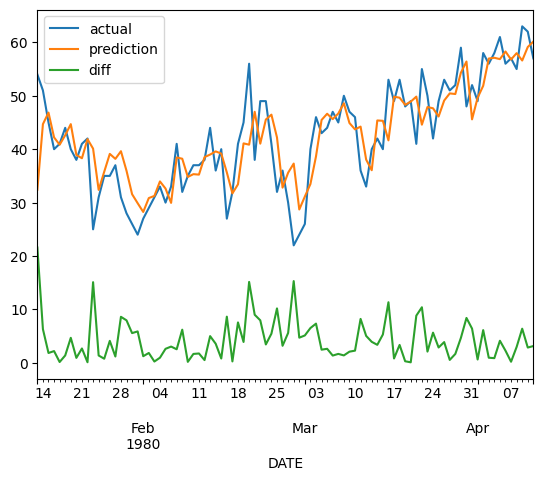

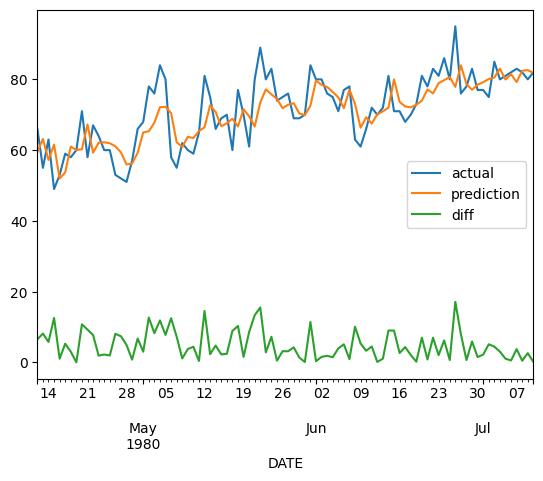

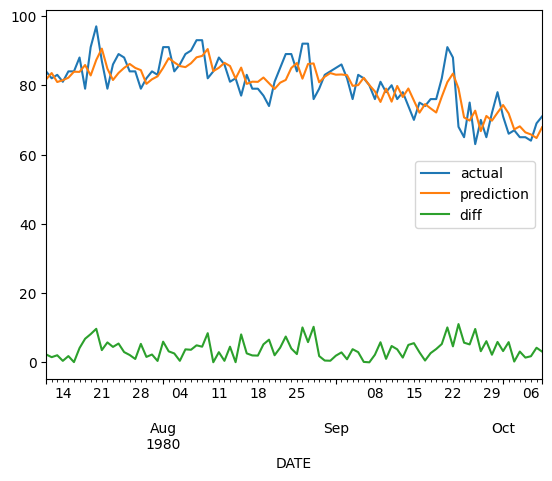

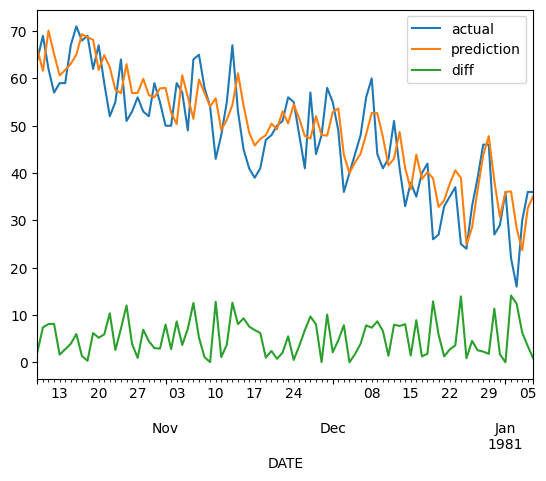

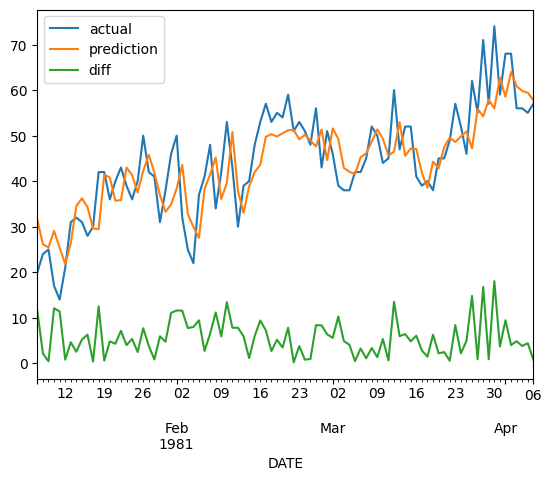

...

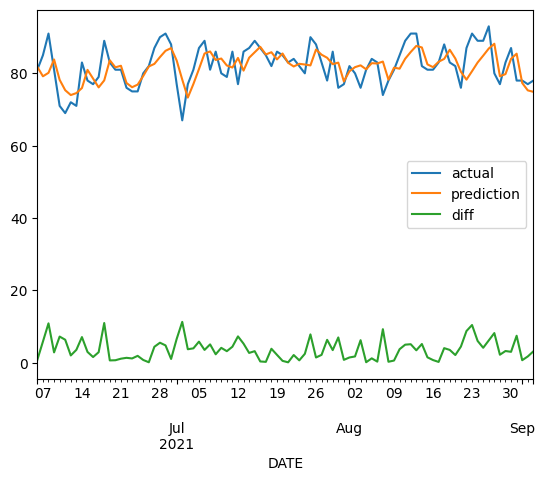

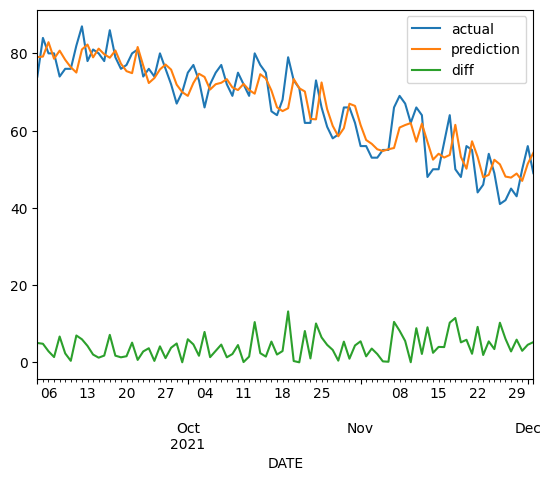

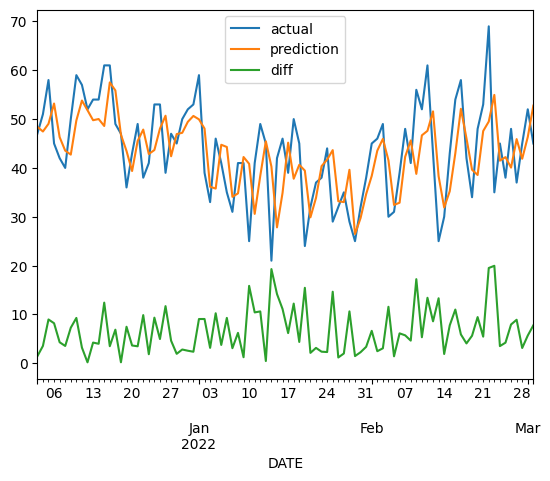

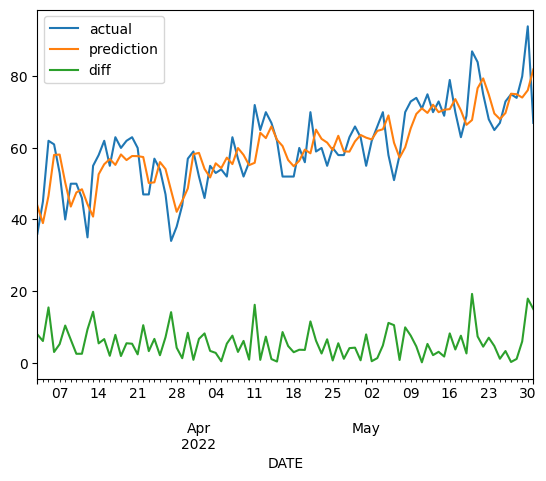

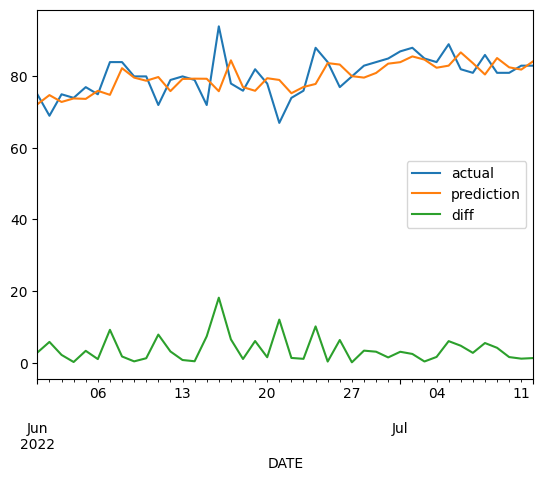

In [43]:
predictions=backtest(weather,rr,predictors)

In [44]:
mean_absolute_error(predictions["actual"],predictions["prediction"])

4.799794721057267

In [45]:
predictions.sort_values("diff",ascending=False)

,actual,prediction,diff
DATE,,,
1990-03-12,85.0,54.361065,30.638935
2007-03-26,78.0,49.965413,28.034587
1998-03-26,80.0,51.966675,28.033325
2003-04-15,86.0,59.432179,26.567821
1985-04-18,84.0,58.425960,25.574040
...,...,...,...
1987-09-16,75.0,75.001185,0.001185
1984-08-10,83.0,82.999179,0.000821
2011-09-25,78.0,77.999237,0.000763


In [46]:
weather.loc["1990-03-07":"1990-03-17"]

,station,name,prcp,snow,snwd,tmax,tmin,target,rolling_3_tmax,rolling_3_tmax_pct,...,rolling_14_tmin,rolling_14_tmin_pct,rolling_14_prcp,rolling_14_prcp_pct,month_avg_tmax,day_avg_tmax,month_avg_tmin,day_avg_tmin,month_avg_prcp,day_avg_prcp
DATE,,,,,,,,,,,,,,,,,,,,,
1990-03-07,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,2.0,32,14,39.0,33.666667,-0.049505,...,25.000000,-0.440000,0.047857,-1.000000,48.590112,45.428571,34.567783,31.857143,0.119410,0.111429
1990-03-08,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,1.0,39,20,43.0,35.000000,0.114286,...,24.071429,-0.169139,0.040714,-1.000000,48.574841,46.571429,34.544586,31.190476,0.119220,0.076667
1990-03-09,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.01,0.0,0.0,43,29,47.0,38.000000,0.131579,...,22.785714,0.272727,0.031429,-0.681818,48.565978,45.619048,34.535771,30.952381,0.119046,0.036190
1990-03-10,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.01,0.0,0.0,47,39,59.0,43.000000,0.093023,...,23.428571,0.664634,0.020714,-0.517241,48.563492,43.809524,34.542857,31.761905,0.118873,0.071905
1990-03-11,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.05,0.0,0.0,59,41,59.0,49.666667,0.187919,...,25.500000,0.607843,0.021429,1.333333,48.580032,46.142857,34.553090,31.904762,0.118764,0.126667
1990-03-12,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,59,43,85.0,55.000000,0.072727,...,27.928571,0.539642,0.021429,-1.000000,48.596519,48.142857,34.566456,34.285714,0.118576,0.167619
1990-03-13,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,85,41,62.0,67.666667,0.256158,...,29.500000,0.389831,0.020000,-1.000000,48.654028,48.761905,34.576619,34.285714,0.118389,0.091429
1990-03-14,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,62,46,55.0,68.666667,-0.097087,...,30.857143,0.490741,0.020000,-1.000000,48.675079,50.190476,34.594637,36.809524,0.118202,0.259524
1990-03-15,USW00094789,"JFK INTERNATIONAL AIRPORT, NY US",0.00,0.0,0.0,55,43,62.0,67.333333,-0.183168,...,32.214286,0.334812,0.020000,-1.000000,48.685039,49.714286,34.607874,35.761905,0.118016,0.066667


In [47]:
predictions["diff"].round().value_counts().sort_index()

,count
diff,
0.0,1130
1.0,2136
2.0,1986
3.0,1829
4.0,1579
5.0,1373
6.0,1144
7.0,1010
8.0,791


<Axes: xlabel='diff'>

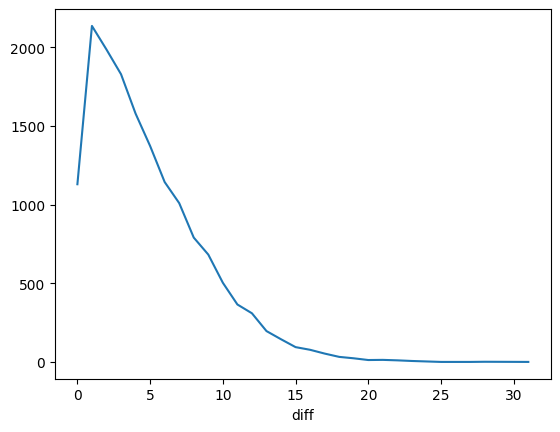

In [48]:
predictions["diff"].round().value_counts().sort_index().plot()